<a href="https://colab.research.google.com/github/aurasagita/PCVK_2023/blob/main/Kelompok_3_Aura_bryan_Masfudin_Week6_PVCK.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

PRAKTIKUM PCVK MINGGU KE 6

NAMA KELOMPOK 3 :

1. Aura Sagita Ashilah  (2141720102)

2. Bryan toshin Saputro (2141720220)

3. Masfudin Dwi Cahyo   (2141720010)



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


<a href="https://colab.research.google.com/github/salmaannissa/PCVK_28_Salma/blob/main/Week5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


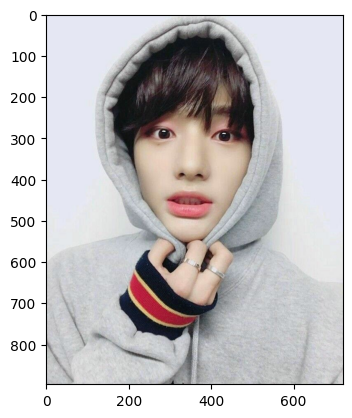

In [2]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

img = cv.imread('/content/drive/MyDrive/PCVK/hyunjin.jpg')
img_RGB = cv.cvtColor(img,cv.COLOR_BGR2RGB)
plt.imshow(img_RGB)

**1. Gamma Correction**

Gamma correction pada citra
---------------------------
Masukkan nilai gamma : 3


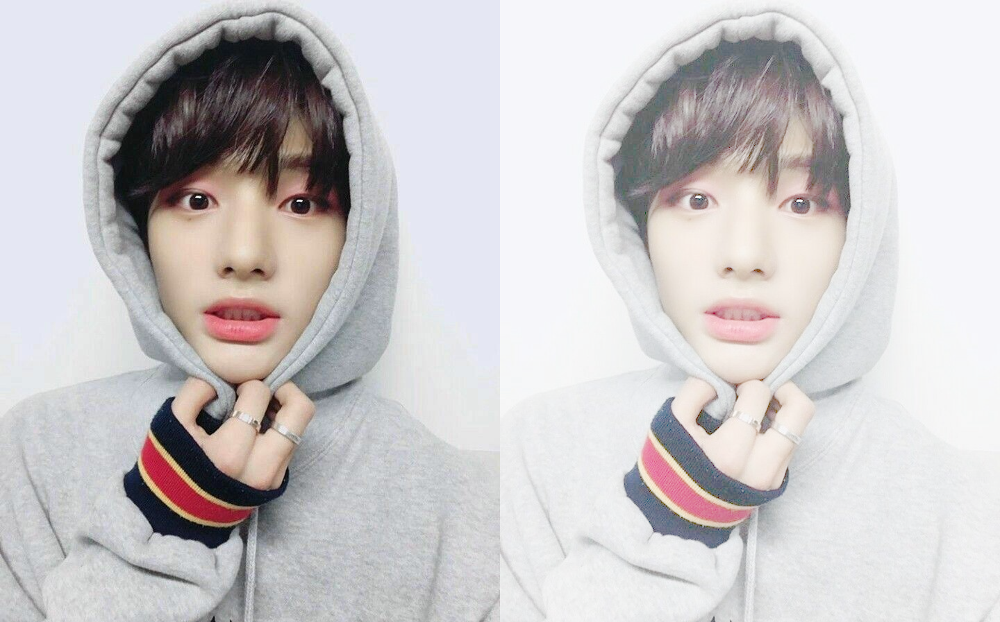

In [3]:
print('Gamma correction pada citra')
print('---------------------------')
try:
  gamma = int(input('Masukkan nilai gamma : '))
except ValueError:
  print('Error, not a number')

original = cv.cvtColor(img_RGB,cv.COLOR_BGR2RGB);
gamma_image = np.zeros(original.shape, original.dtype)

for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      gamma_image[y,x,c] = np.clip(255 * pow(original[y,x,c] / 255, (1/gamma)), 0, 255)

final_frame = cv.hconcat((original, gamma_image))
cv2_imshow(final_frame)

**2. Image Depth**

Image Depth pada citra
----------------------


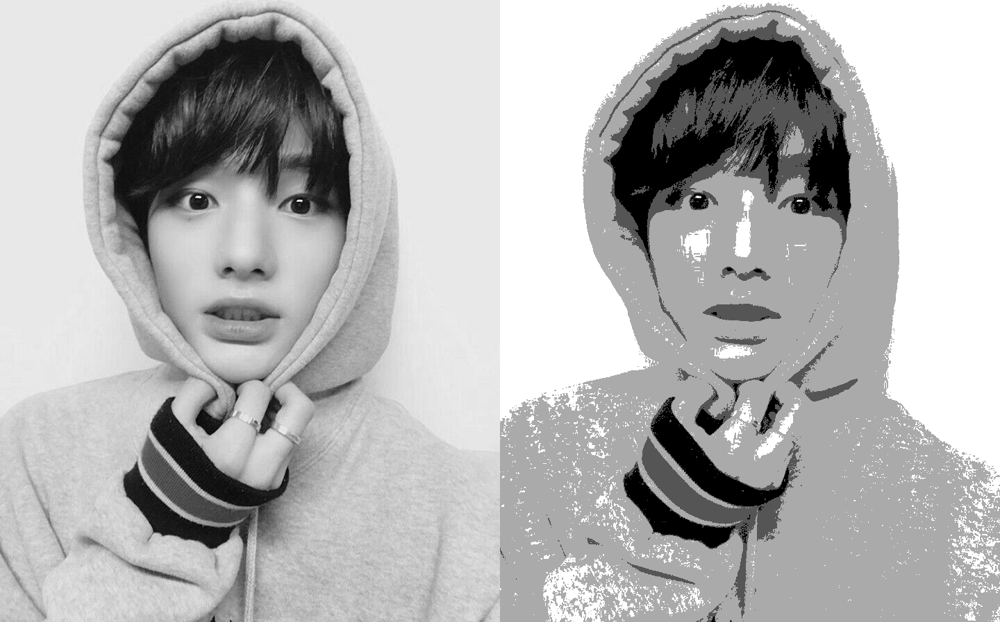

In [5]:
print('Image Depth pada citra')
print('----------------------')

bit_depth = 2
level = 255 / (pow(2,bit_depth)-1)
original = cv.imread('/content/drive/MyDrive/PCVK/hyunjin.jpg', cv.IMREAD_GRAYSCALE)
img_depth = np.zeros(original.shape,original.dtype)

# melakukan akses setiap piksel pada grayscale
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    img_depth[y,x] = np.clip(round(original[y,x] / level)*level,0,255)

final_frame = cv.hconcat((original,img_depth))
cv2_imshow(final_frame)

**3. Average Denoising**



Nilai PSNR dengan 5 citra :  22.45123546693677  dB


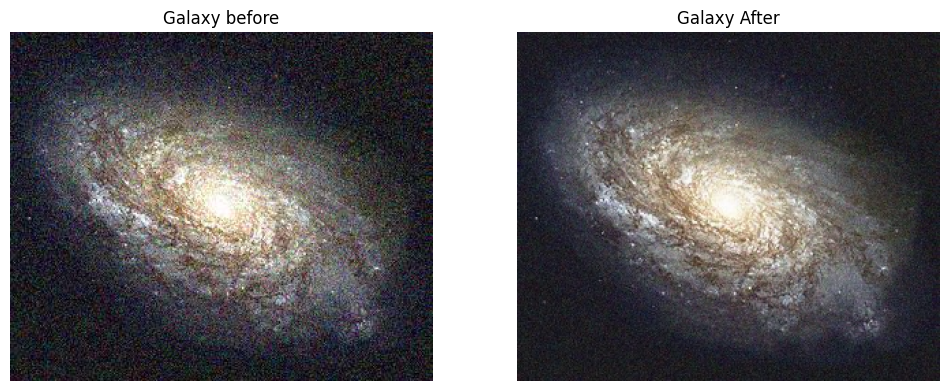

In [18]:
import glob
import cv2
from math import sqrt, log10

def PSNR(img1, img2):
  mse = np.mean((img1-img2)**2)
  if(mse==0):
    return 100
  max_pixel = 255.0
  psnr = 20 * log10(max_pixel / sqrt(mse))
  return psnr

# membaca citra asli
original_img = cv.imread('/content/drive/MyDrive/PCVK/galaxy.jpg')

# membaca semua citra yang tersimpan dalam satu folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/noises/*.jpg'):
  n = cv.imread(img)
  cv_img.append(n)

denoised_img = np.zeros(cv_img[0].shape)
jmlGambar = 5
for i in range(jmlGambar):
  denoised_img = denoised_img + cv_img[i]
denoised_img = np.uint16(denoised_img/jmlGambar)

psnr = PSNR(original_img,denoised_img)

print('Nilai PSNR dengan 5 citra : ', psnr, ' dB')
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(cv_img[0], cv2.COLOR_BGR2RGB))
plt.title('Galaxy before')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(denoised_img, cv2.COLOR_BGR2RGB))
plt.title('Galaxy After')
plt.axis('off')

plt.show()

Nilai PSNR dengan 10 citra :  22.82719612774177  dB


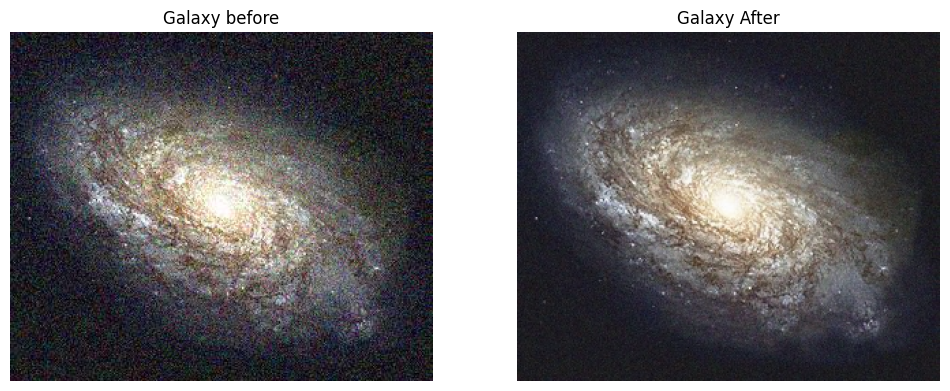

In [21]:
# membaca citra asli
original_img = cv.imread('/content/drive/MyDrive/PCVK/galaxy.jpg')

# membaca semua citra yang tersimpan dalam satu folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/noises/*.jpg'):
  n = cv.imread(img)
  cv_img.append(n)

denoised_img = np.zeros(cv_img[0].shape)
jmlGambar = 10
for i in range(jmlGambar):
  denoised_img = denoised_img + cv_img[i]
denoised_img = np.uint16(denoised_img/jmlGambar)

psnr = PSNR(original_img,denoised_img)

print('Nilai PSNR dengan 10 citra : ', psnr, ' dB')
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(cv_img[0], cv2.COLOR_BGR2RGB))
plt.title('Galaxy before')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(denoised_img, cv2.COLOR_BGR2RGB))
plt.title('Galaxy After')
plt.axis('off')

plt.show()

Nilai PSNR dengan 20 citra :  23.031137051370905  dB


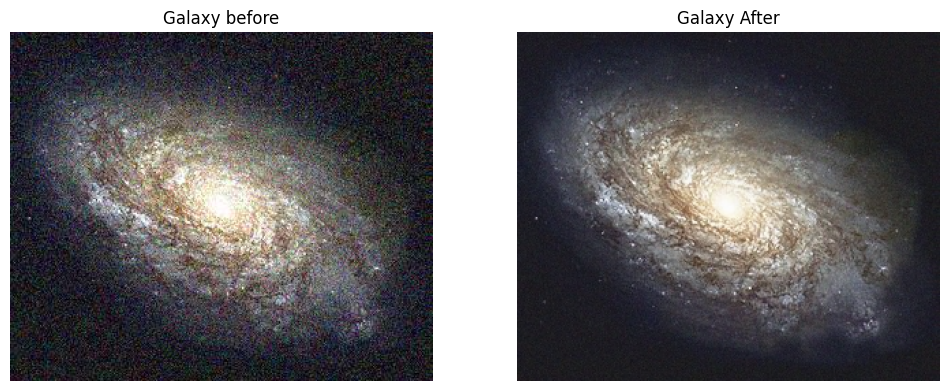

In [23]:
# membaca citra asli
original_img = cv.imread('/content/drive/MyDrive/PCVK/galaxy.jpg')

# membaca semua citra yang tersimpan dalam satu folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/noises/*.jpg'):
  n = cv.imread(img)
  cv_img.append(n)

denoised_img = np.zeros(cv_img[0].shape)
jmlGambar = 20
for i in range(jmlGambar):
  denoised_img = denoised_img + cv_img[i]
denoised_img = np.uint16(denoised_img/jmlGambar)

psnr = PSNR(original_img,denoised_img)

print('Nilai PSNR dengan 20 citra : ', psnr, ' dB')
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(cv_img[0], cv2.COLOR_BGR2RGB))
plt.title('Galaxy before')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(denoised_img, cv2.COLOR_BGR2RGB))
plt.title('Galaxy After')
plt.axis('off')

plt.show()

Nilai PSNR dengan 40 citra :  23.135895287728935  dB


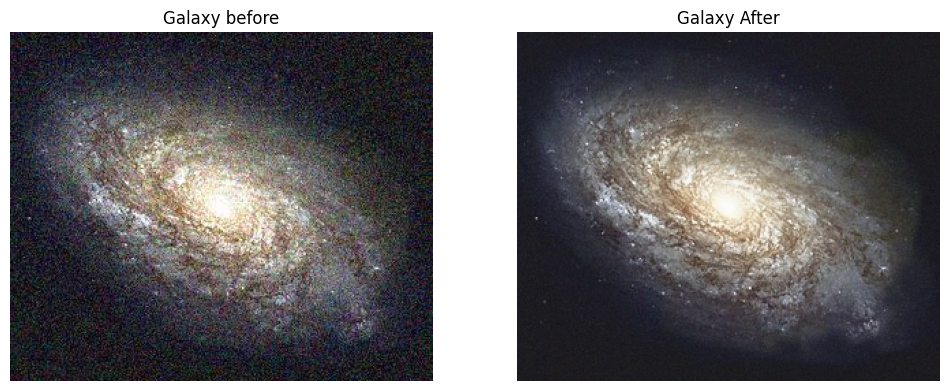

In [24]:
# membaca citra asli
original_img = cv.imread('/content/drive/MyDrive/PCVK/galaxy.jpg')

# membaca semua citra yang tersimpan dalam satu folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/noises/*.jpg'):
  n = cv.imread(img)
  cv_img.append(n)

denoised_img = np.zeros(cv_img[0].shape)
jmlGambar = 40
for i in range(jmlGambar):
  denoised_img = denoised_img + cv_img[i]
denoised_img = np.uint16(denoised_img/jmlGambar)

psnr = PSNR(original_img,denoised_img)
print('Nilai PSNR dengan 40 citra : ', psnr, ' dB')
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(cv_img[0], cv2.COLOR_BGR2RGB))
plt.title('Galaxy before')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(denoised_img, cv2.COLOR_BGR2RGB))
plt.title('Galaxy After')
plt.axis('off')

plt.show()

Nilai PSNR dengan 80 citra :  23.186462409770012  dB


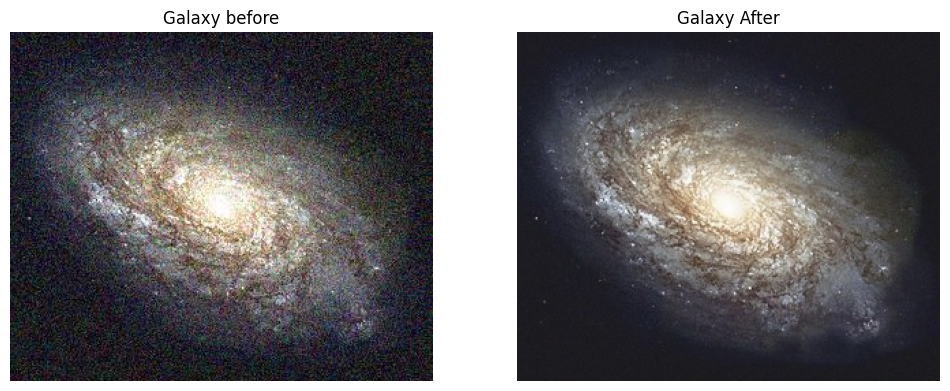

In [25]:
# membaca citra asli
original_img = cv.imread('/content/drive/MyDrive/PCVK/galaxy.jpg')

# membaca semua citra yang tersimpan dalam satu folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/noises/*.jpg'):
  n = cv.imread(img)
  cv_img.append(n)

denoised_img = np.zeros(cv_img[0].shape)
jmlGambar = 80
for i in range(jmlGambar):
  denoised_img = denoised_img + cv_img[i]
denoised_img = np.uint16(denoised_img/jmlGambar)

psnr = PSNR(original_img,denoised_img)

print('Nilai PSNR dengan 80 citra : ', psnr, ' dB')
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(cv_img[0], cv2.COLOR_BGR2RGB))
plt.title('Galaxy before')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(denoised_img, cv2.COLOR_BGR2RGB))
plt.title('Galaxy After')
plt.axis('off')

plt.show()

Nilai PSNR dengan 80 citra :  23.28332752276434  dB


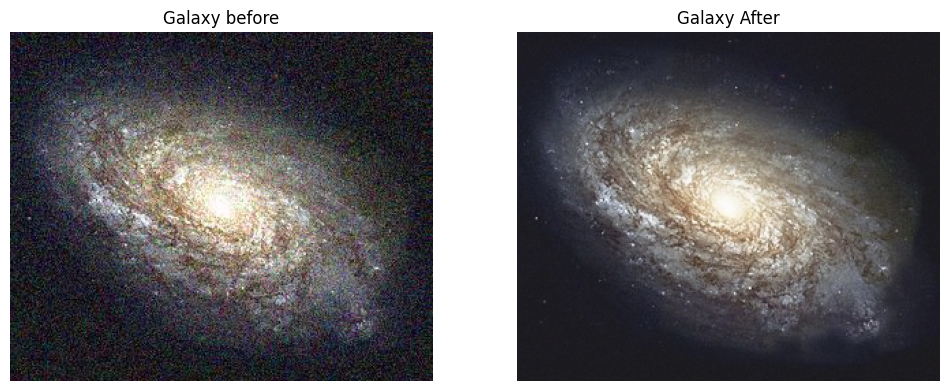

In [28]:
# membaca citra asli
original_img = cv.imread('/content/drive/MyDrive/PCVK/galaxy.jpg')

# membaca semua citra yang tersimpan dalam satu folder
cv_img = []
for img in glob.glob('/content/drive/MyDrive/PCVK/noises/*.jpg'):
  n = cv.imread(img)
  cv_img.append(n)

denoised_img = np.zeros(cv_img[0].shape)
jmlGambar = 100
for i in range(jmlGambar):
  denoised_img = denoised_img + cv_img[i]
denoised_img = np.uint16(denoised_img/jmlGambar)

psnr = PSNR(original_img,denoised_img)

print('Nilai PSNR dengan 80 citra : ', psnr, ' dB')
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(cv_img[0], cv2.COLOR_BGR2RGB))
plt.title('Galaxy before')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(denoised_img, cv2.COLOR_BGR2RGB))
plt.title('Galaxy After')
plt.axis('off')

plt.show()

Dari hasil perhitungan PSNR yang telah dilakukan maka dapat disimpulkan bahwa semakin besar nilai PSNR maka gambar yang dihasilkan akan semakin bagus. Pada percobaan menggunakan denoised dengan lima citra, citra yang dihasilkan menjadi pecah. Sedangkan pada 100 citra yang digunakan untuk denoised, citra yang dihasilkan menjadi lebih halus.

**4. Image Masking**


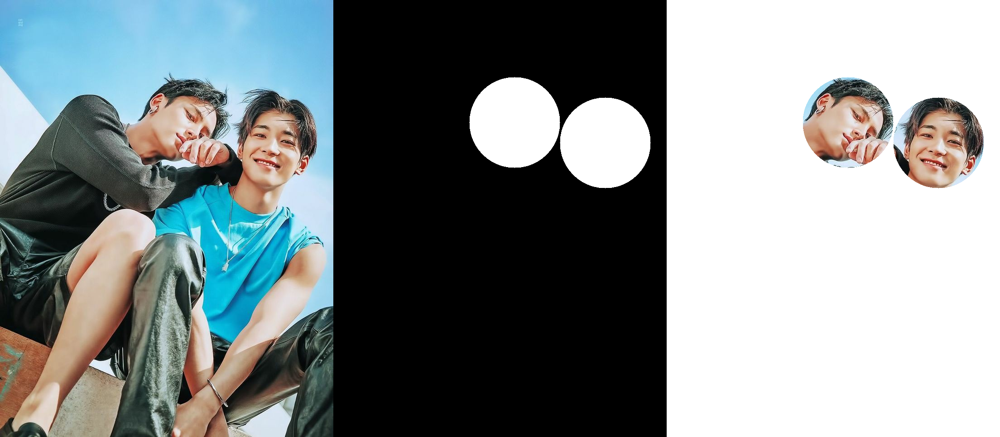

In [49]:
# menggunakan operator and
img = cv.imread('/content/drive/MyDrive/PCVK/wonwoo&mingyu.jpg')
mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,315), 100, (255,255,255), -1)

mask2 = np.zeros(img.shape, dtype=np.uint8)
mask2 = cv.circle(mask, (400,270), 100, (255,255,255), -1)

result = img & mask & mask2
result[mask==0] = 255

final_frame = cv.hconcat((img,mask,result))
cv2_imshow(final_frame)

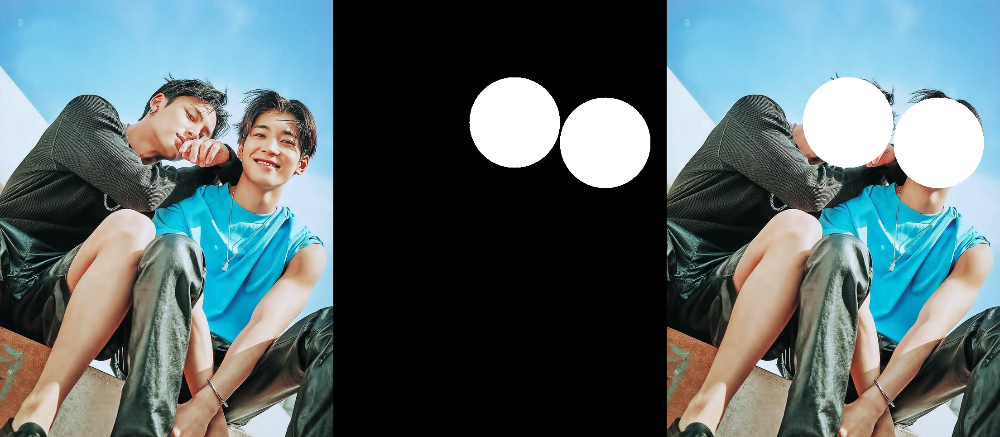

In [50]:
# menggunakan operator or

mask = np.zeros(img.shape,img.dtype)
mask = cv.circle(mask, (600,315), 100, (255,255,255), -1)

result = img & mask

mask2 = np.zeros(img.shape, img.dtype)
mask2 = cv.circle(mask, (400,270), 100, (255,255,255), -1)

result = img & mask2

masked = img | mask

final_frame = cv.hconcat((img,mask,masked))
cv2_imshow(final_frame)

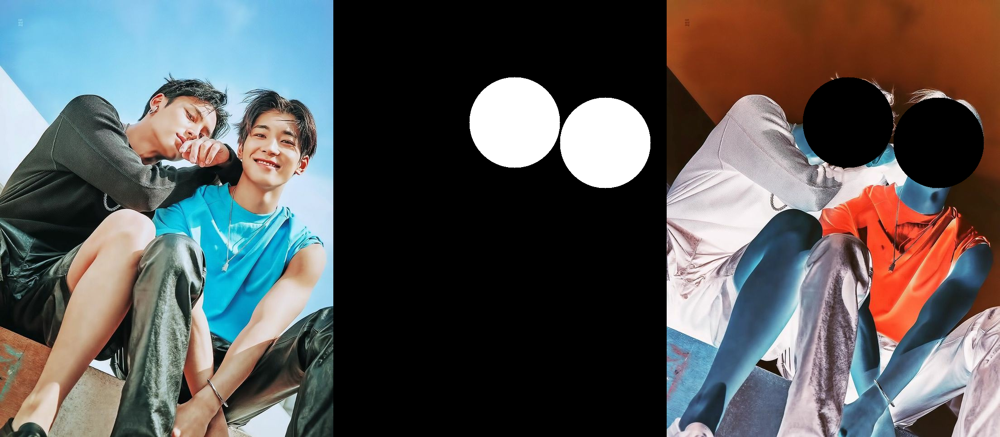

In [51]:
# menggunakan operator not

mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,315), 100, (255,255,255), -1)

result = img & mask

mask2 = np.zeros(img.shape,dtype=np.uint8)
mask2 = cv.circle(mask, (400,270), 100, (255,255,255), -1)

result = img & mask2

masked = ~img & ~mask

final_frame = cv.hconcat((img, mask, masked))
cv2_imshow(final_frame)

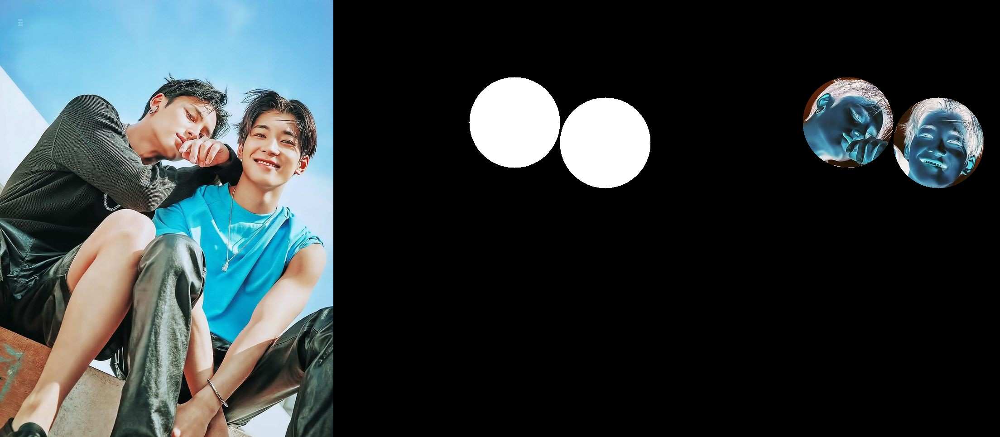

In [52]:
# menggunakan operator nand

mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,315), 100, (255,255,255), -1)
mask2 = np.zeros(img.shape,dtype=np.uint8)
mask2 = cv.circle(mask, (400,270), 100, (255,255,255), -1)

masked = ~img & mask

final_frame = cv.hconcat((img, mask, masked))
cv2_imshow(final_frame)

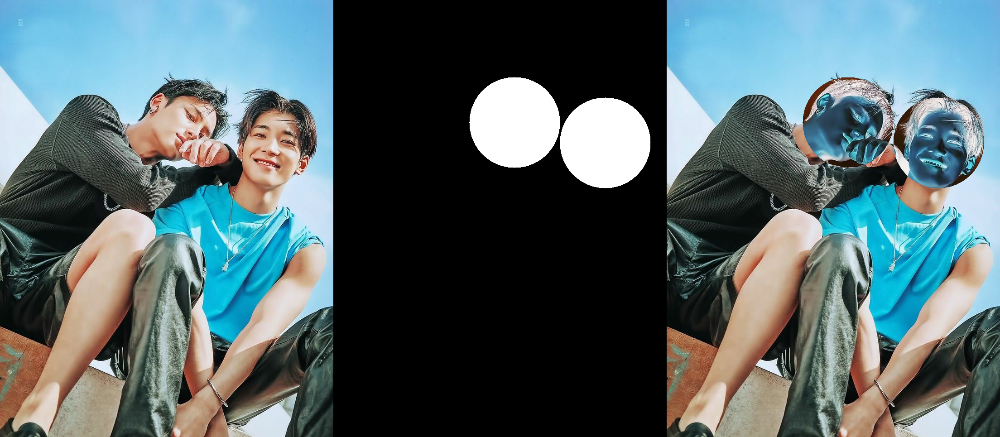

In [53]:
# menggunakan operator xor

mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,315), 100, (255,255,255), -1)
mask2 = np.zeros(img.shape,dtype=np.uint8)
mask2 = cv.circle(mask, (400,270), 100, (255,255,255), -1)

masked = cv.bitwise_xor(img, mask)

final_frame = cv.hconcat((img, mask, masked))
cv2_imshow(final_frame)

Kelompok 3 (bagian Hidung)
5. Lakukan percobaan menggunakan operator lain dan tunjukkan hasilnya pada modul ini.
Tuliskan hasil analisa anda kenapa citra keluarannya seperti itu.

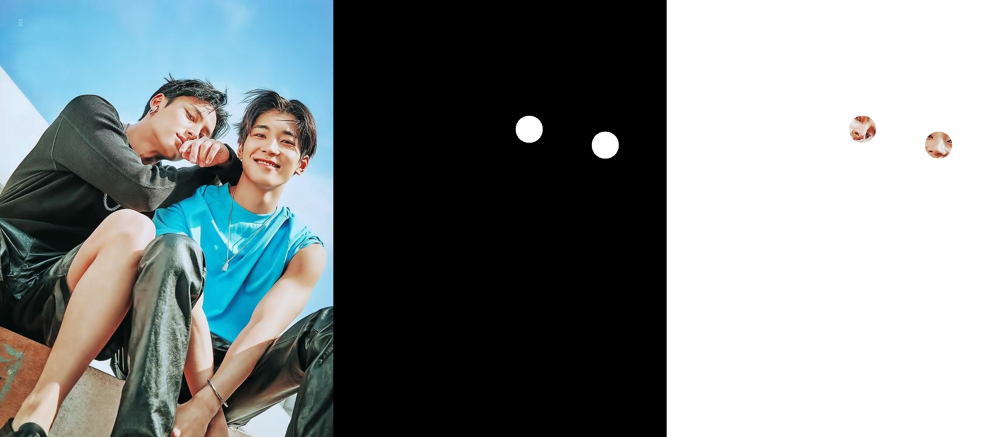

In [82]:
# menggunakan operator and
img = cv.imread('/content/drive/MyDrive/PCVK/wonwoo&mingyu.jpg')
mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,320), 30, (255,255,255), -1)

mask2 = np.zeros(img.shape, dtype=np.uint8)
mask2 = cv.circle(mask, (432,285), 30, (255,255,255), -1)

result = img & mask & mask2
result[mask==0] = 255

final_frame = cv.hconcat((img,mask,result))
cv2_imshow(final_frame)

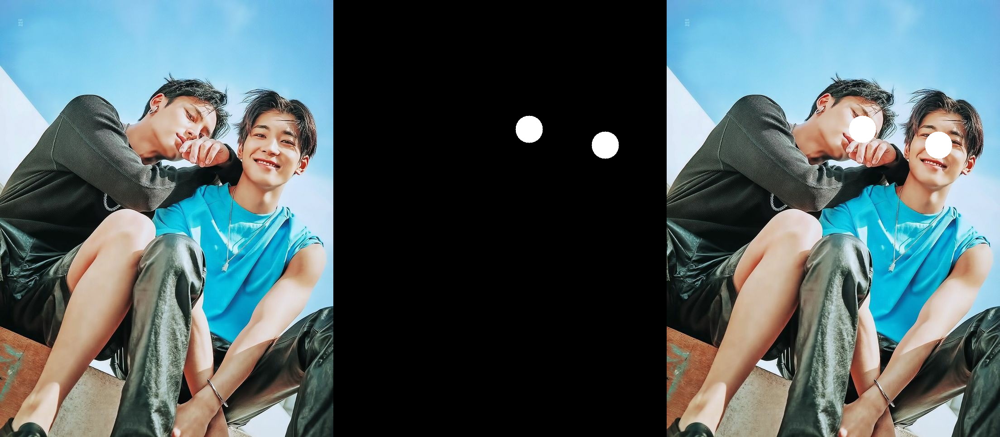

In [83]:
# menggunakan operator or
mask = np.zeros(img.shape,img.dtype)
mask = cv.circle(mask, (600,320), 30, (255,255,255), -1)

result = img & mask

mask2 = np.zeros(img.shape, img.dtype)
mask2 = cv.circle(mask, (432,285), 30, (255,255,255), -1)

result = img & mask2

masked = img | mask

final_frame = cv.hconcat((img,mask,masked))
cv2_imshow(final_frame)

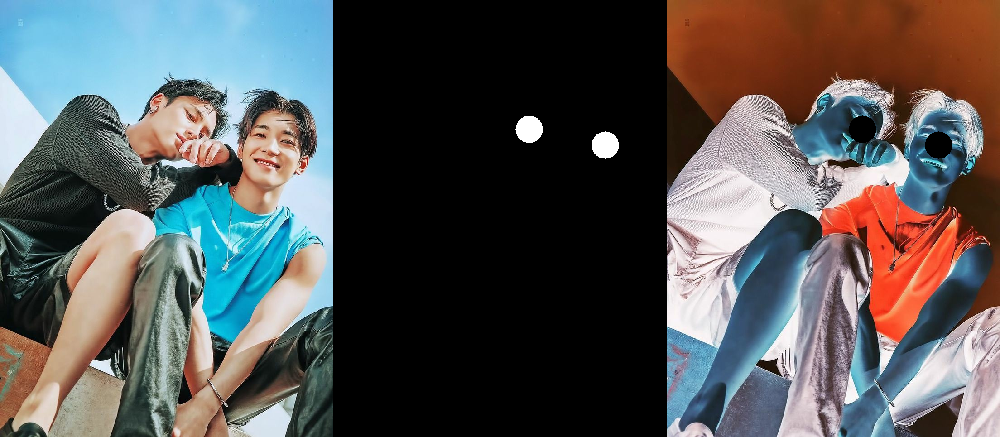

In [84]:
# menggunakan operator not

mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,320), 30, (255,255,255), -1)
result = img & mask
mask2 = np.zeros(img.shape,dtype=np.uint8)
mask2 = cv.circle(mask, (432,285), 30, (255,255,255), -1)

result = img & mask2

masked = ~img & ~mask

final_frame = cv.hconcat((img, mask, masked))
cv2_imshow(final_frame)

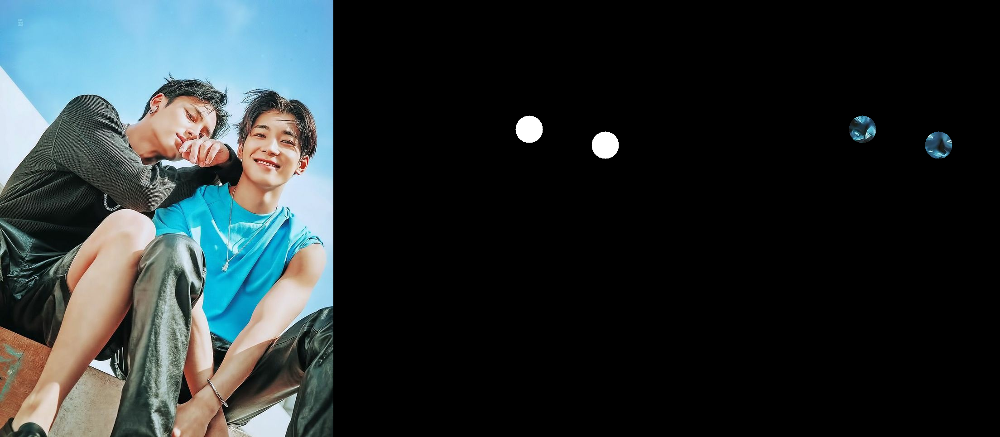

In [85]:
# menggunakan operator nand

mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,320), 30, (255,255,255), -1)
mask2 = np.zeros(img.shape,dtype=np.uint8)
mask2 = cv.circle(mask, (432,285), 30, (255,255,255), -1)

masked = ~img & mask

final_frame = cv.hconcat((img, mask, masked))
cv2_imshow(final_frame)

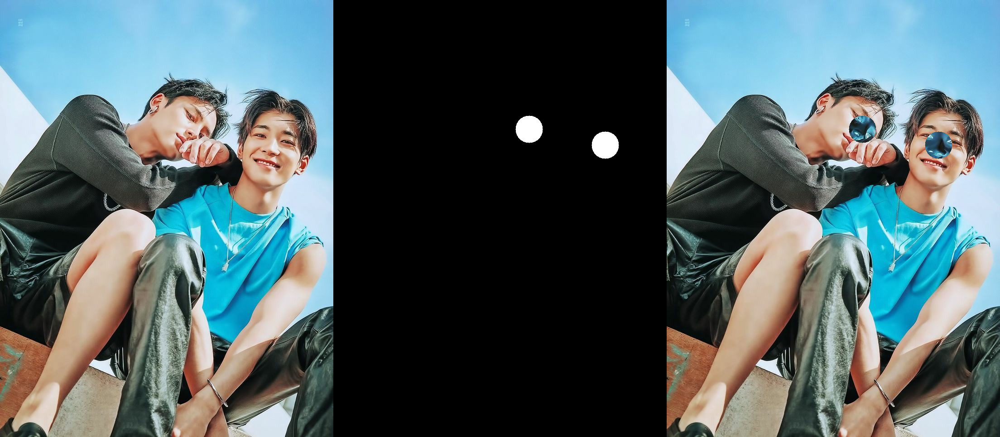

In [86]:
# menggunakan operator xor

mask = np.zeros(img.shape,dtype=np.uint8)
mask = cv.circle(mask, (600,320), 30, (255,255,255), -1)
mask2 = np.zeros(img.shape,dtype=np.uint8)
mask2 = cv.circle(mask, (432,285), 30, (255,255,255), -1)

masked = cv.bitwise_xor(img, mask)

final_frame = cv.hconcat((img, mask, masked))
cv2_imshow(final_frame)

Dari percobaan image masking di atas dapat disimpulkan bahwa :
- AND merupakan operator yang menghasilkan masking pada bagian selain circle.
- OR merupakan operator yang menghasilkan masking pada bagian circle.
- NOT merupakan operator yang menghasilkan masking pada circle dengan warna hitam dan citra negatif pada pixel selain bagian masking.
- NAND merupakan operator yang menghasilkan masking pada bagian selain circle dengan warna hitam dan citra negatif pada pixel selain bagian masking.
- XOR merupakan operator yang menghasilkan masking pada bagian circle dengan citra negatif dan warna asli pada pixel selain bagian masking.